In [1]:
from keras.utils import load_img, img_to_array
import os
import numpy as np
import matplotlib.pyplot as plt
import keras
import random
from PIL import Image
import cv2
import tensorflow as tf
print(tf.__version__)

2.11.0


In [2]:
## If you are using the data by mounting the google drive, use the following :
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)

Mounted at /content/gdrive


In [10]:
tf_model1_file = "gdrive/MyDrive/models/snow_nosnow_detect_model.tflite"
tf_model2_file = 'gdrive/MyDrive/models/updated_snow_detection_on_solar_panel_model.tflite'

### Model 1 - {0: "snow", 1: "no_snow"} 

In [3]:
def predict_from_two_classes(tf_model_file, class_dict, img_path, size=(256, 256)):
  interpreter = tf.lite.Interpreter(model_path=tf_model_file)
  signature = interpreter.get_signature_list()
  # print(signature)
  # Load and preprocess your image
  img = load_img(img_path, target_size=size)

  # Show image
  plt.imshow(img)
  plt.show()

  interpreter = tf.lite.Interpreter(model_path=tf_model_file)
  interpreter.allocate_tensors()

  input_details = interpreter.get_input_details()
  output_details = interpreter.get_output_details()

  # Load and preprocess the image
  img = Image.open(img_path)
  img = img.resize(size)
  img_array = np.array(img) / 255.0
  img_array = np.expand_dims(img_array, axis=0)
  # Convert the data type of the input tensor to FLOAT32
  img_array = tf.cast(img_array, tf.float32)


  # input_shape = input_details[0]['shape']
  # input_data = np.array(img, dtype=np.float32)
  interpreter.set_tensor(input_details[0]['index'], img_array)

  # interpreter = tf.lite.Interpreter(model_path=tf_model_file)
  # interpreter.allocate_tensors()
  interpreter.invoke()

  output_data = interpreter.get_tensor(output_details[0]['index'])
  print(output_data)

  prediction = 1 if output_data > 0.5 else 0
  print(prediction)
  if prediction == 0:
      predicted_label = class_dict[1]
  else:
      predicted_label = class_dict[0]

  print(predicted_label)
  return predicted_label


In [4]:
!ls "/content/gdrive/MyDrive/Snow_Covered_Solar_Panel_Detect/snow_and_nosnow_images"

test  train  validate


In [5]:
FAST_RUN = False
IMAGE_WIDTH=256
IMAGE_HEIGHT=256
IMAGE_SIZE=(IMAGE_WIDTH, IMAGE_HEIGHT)
IMAGE_CHANNELS=3
BATCH_SIZE = 32

In [6]:
# Set the directory for the training images
test_dir = '/content/gdrive/MyDrive/Snow_Covered_Solar_Panel_Detect/snow_and_nosnow_images/test'
validation_dir = '/content/gdrive/MyDrive/Snow_Covered_Solar_Panel_Detect/snow_and_nosnow_images/validate'

In [7]:
class_dict = {0: "snow", 1: "no_snow"}

In [11]:
# Load the saved model
TF_MODEL_FILE_PATH = tf_model1_file

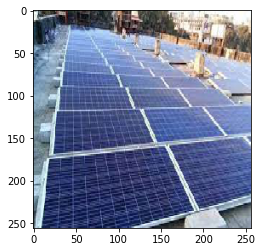

[[0.00578805]]
0
no_snow


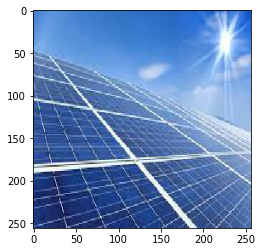

[[0.00195164]]
0
no_snow


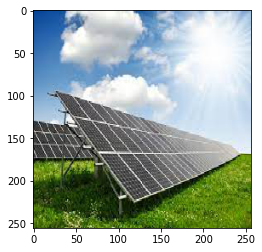

[[0.00027599]]
0
no_snow


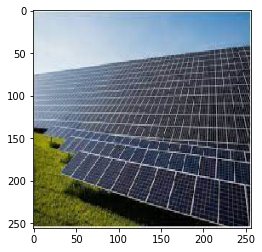

[[0.00284053]]
0
no_snow


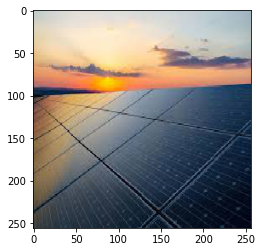

[[0.01774371]]
0
no_snow


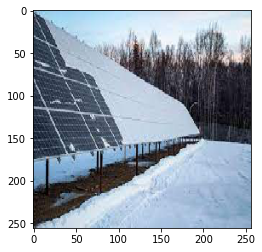

[[0.9990111]]
1
snow


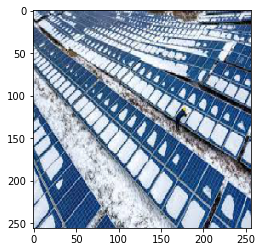

[[0.99999946]]
1
snow


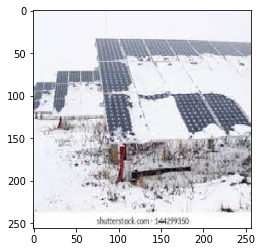

[[0.9999991]]
1
snow


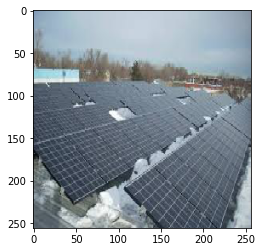

[[0.03997208]]
0
no_snow


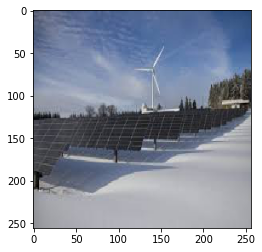

[[0.9885676]]
1
snow


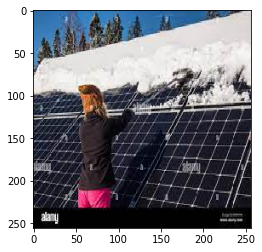

[[0.9970667]]
1
snow


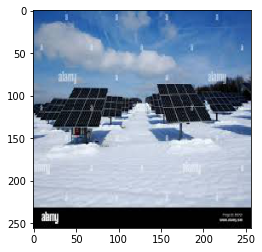

[[0.9999533]]
1
snow


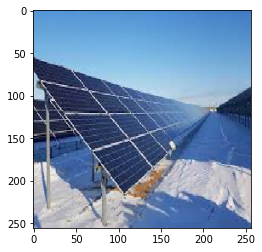

[[0.74828553]]
1
snow


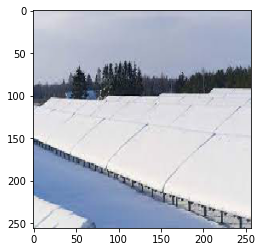

[[0.9999799]]
1
snow


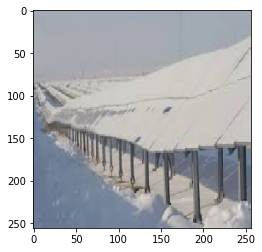

[[0.9977013]]
1
snow


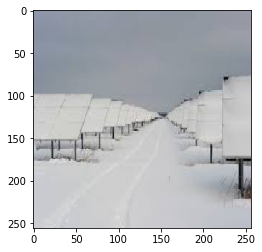

[[0.98421884]]
1
snow


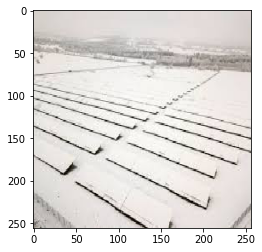

[[0.9651722]]
1
snow


In [12]:
for img_path in os.listdir(test_dir + "/no_snow"):
  predict_from_two_classes(TF_MODEL_FILE_PATH, class_dict, (os.path.join(test_dir + "/no_snow", img_path)), size=(256, 256))

for img_path in os.listdir(test_dir + "/snow"):
  predict_from_two_classes(TF_MODEL_FILE_PATH, class_dict, (os.path.join(test_dir + "/snow", img_path)), size=(256, 256))


### Model 2 - {0: "all_snow", 1: "no_snow", 2: "partial_snow"}

Test with tflite model

In [17]:
def predict_from_three_classes(tf_model_file, class_dict, img_path, size=(256, 256)):
  interpreter = tf.lite.Interpreter(model_path=tf_model_file)
  signature = interpreter.get_signature_list()
  # print(signature)
  classify_lite = interpreter.get_signature_runner('serving_default')

  # Load and preprocess your image
  img = load_img(img_path, target_size=size)

  # Show image
  plt.imshow(img)
  plt.show()

  img = img_to_array(img)
  img = np.expand_dims(img, axis=0)
  img = img/255.0

  # change the inputs from signature
  predictions_lite = classify_lite(conv2d_input=img)[signature['serving_default']['outputs'][0]]
  score_lite = tf.nn.softmax(predictions_lite)

  # Get the directory path of the file
  dir_path = os.path.dirname(img_path)

  # Get the last subfolder name
  last_subfolder_name = os.path.basename(dir_path)

  print(
    "Predict: {} with a {:.2f}% confidence. Actually belongs to: {}"
    .format(class_dict[np.argmax(score_lite)], 100 * np.max(score_lite), last_subfolder_name)
  )
  return class_dict[np.argmax(score_lite)]

In [14]:
# Load the saved model
TF_MODEL_FILE_PATH = tf_model2_file

In [15]:
class_dict = {0: "all_snow", 1: "no_snow", 2: "partial_snow"}

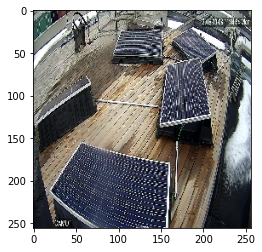

Predict: partial_snow with a 57.31% confidence. Actually belongs to: no_snow


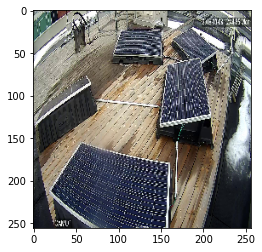

Predict: partial_snow with a 56.32% confidence. Actually belongs to: no_snow


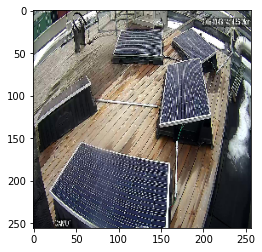

Predict: partial_snow with a 57.36% confidence. Actually belongs to: no_snow


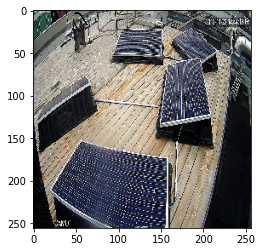

Predict: partial_snow with a 57.54% confidence. Actually belongs to: no_snow


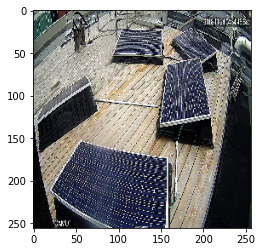

Predict: partial_snow with a 57.58% confidence. Actually belongs to: no_snow


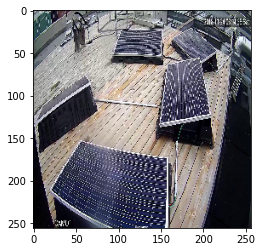

Predict: partial_snow with a 57.61% confidence. Actually belongs to: no_snow


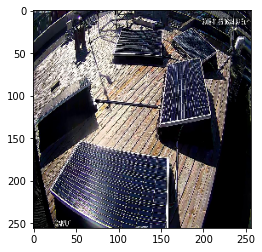

Predict: partial_snow with a 57.61% confidence. Actually belongs to: no_snow


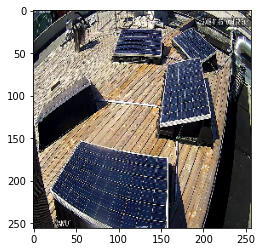

Predict: partial_snow with a 57.61% confidence. Actually belongs to: no_snow


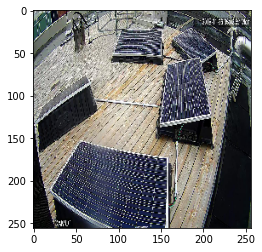

Predict: partial_snow with a 57.60% confidence. Actually belongs to: no_snow


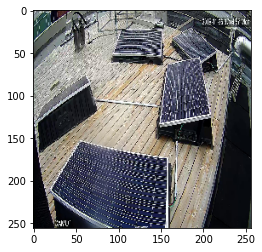

Predict: partial_snow with a 57.60% confidence. Actually belongs to: no_snow


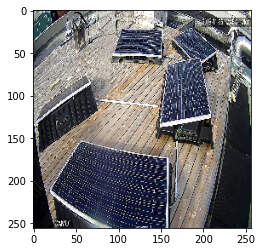

Predict: partial_snow with a 57.23% confidence. Actually belongs to: no_snow


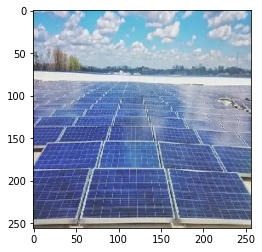

Predict: no_snow with a 56.95% confidence. Actually belongs to: no_snow


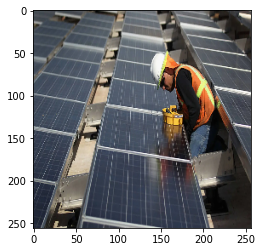

Predict: no_snow with a 56.01% confidence. Actually belongs to: no_snow


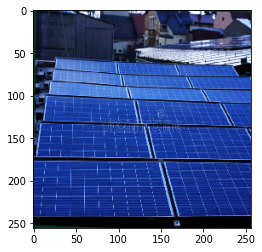

Predict: no_snow with a 46.93% confidence. Actually belongs to: no_snow


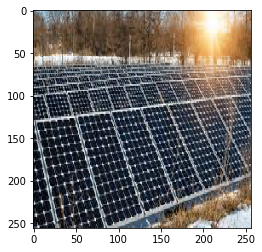

Predict: no_snow with a 57.61% confidence. Actually belongs to: no_snow


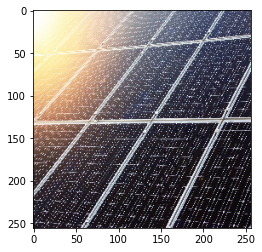

Predict: no_snow with a 57.60% confidence. Actually belongs to: no_snow


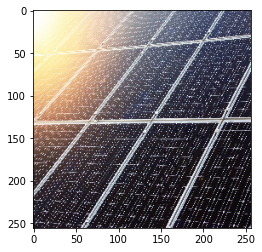

Predict: no_snow with a 57.60% confidence. Actually belongs to: no_snow


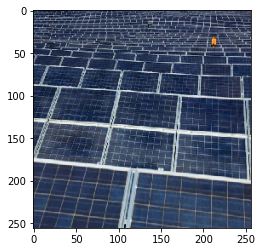

Predict: no_snow with a 56.57% confidence. Actually belongs to: no_snow


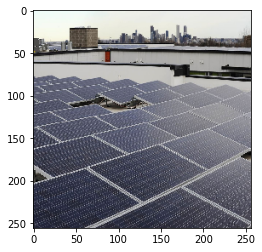

Predict: all_snow with a 41.99% confidence. Actually belongs to: no_snow


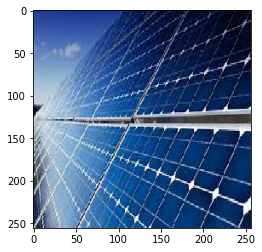

Predict: no_snow with a 57.61% confidence. Actually belongs to: no_snow


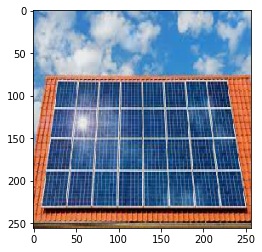

Predict: no_snow with a 57.61% confidence. Actually belongs to: no_snow


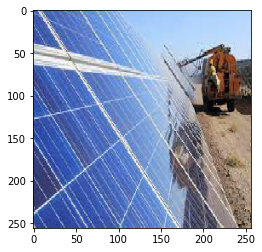

Predict: no_snow with a 50.99% confidence. Actually belongs to: no_snow


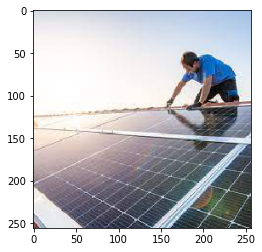

Predict: partial_snow with a 42.77% confidence. Actually belongs to: no_snow


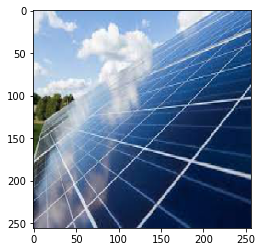

Predict: no_snow with a 57.58% confidence. Actually belongs to: no_snow


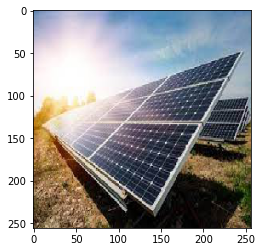

Predict: partial_snow with a 54.11% confidence. Actually belongs to: no_snow


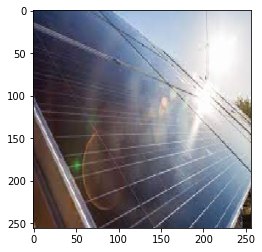

Predict: no_snow with a 55.23% confidence. Actually belongs to: no_snow


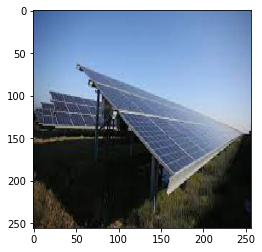

Predict: no_snow with a 52.06% confidence. Actually belongs to: no_snow


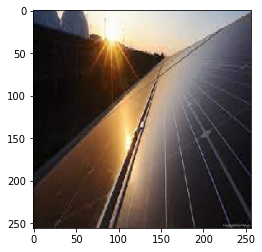

Predict: partial_snow with a 47.96% confidence. Actually belongs to: no_snow


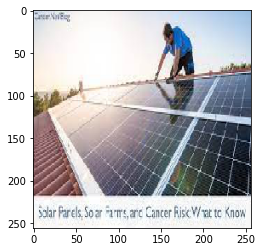

Predict: partial_snow with a 57.51% confidence. Actually belongs to: no_snow


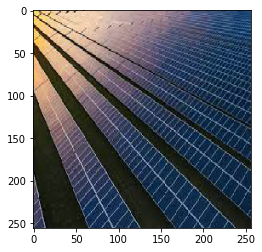

Predict: no_snow with a 57.61% confidence. Actually belongs to: no_snow


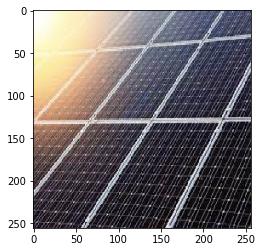

Predict: partial_snow with a 44.44% confidence. Actually belongs to: no_snow


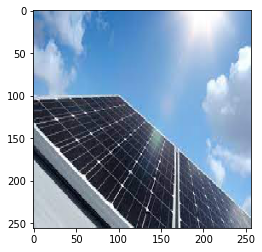

Predict: no_snow with a 57.48% confidence. Actually belongs to: no_snow


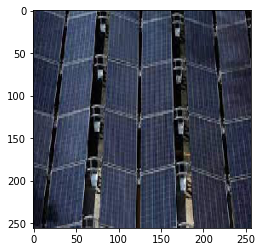

Predict: no_snow with a 57.61% confidence. Actually belongs to: no_snow


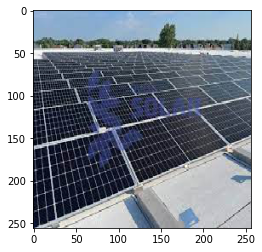

Predict: no_snow with a 47.08% confidence. Actually belongs to: no_snow


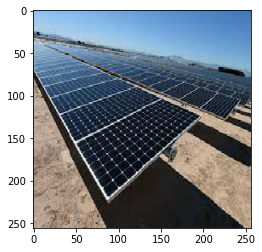

Predict: no_snow with a 57.61% confidence. Actually belongs to: no_snow


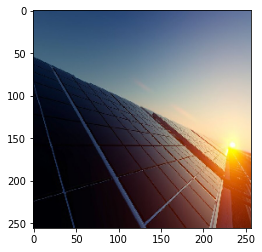

Predict: no_snow with a 41.87% confidence. Actually belongs to: no_snow


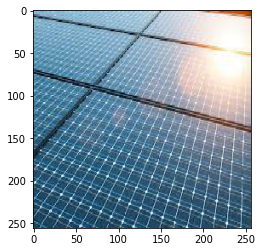

Predict: no_snow with a 57.61% confidence. Actually belongs to: no_snow


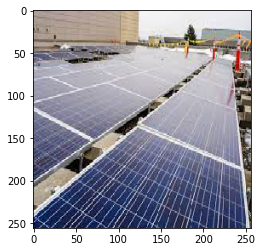

Predict: no_snow with a 57.37% confidence. Actually belongs to: no_snow


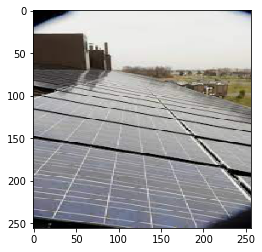

Predict: all_snow with a 34.77% confidence. Actually belongs to: no_snow


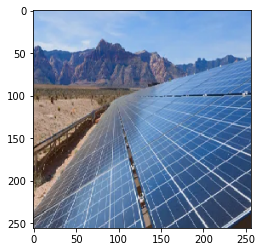

Predict: no_snow with a 57.49% confidence. Actually belongs to: no_snow


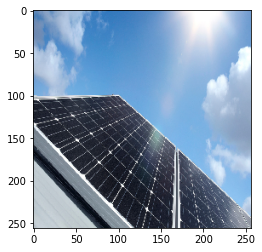

Predict: no_snow with a 57.54% confidence. Actually belongs to: no_snow


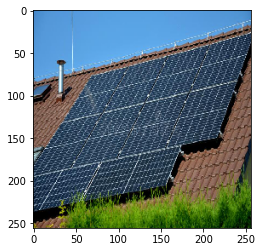

Predict: no_snow with a 57.61% confidence. Actually belongs to: no_snow


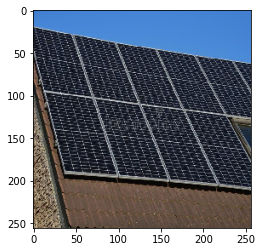

Predict: no_snow with a 57.61% confidence. Actually belongs to: no_snow


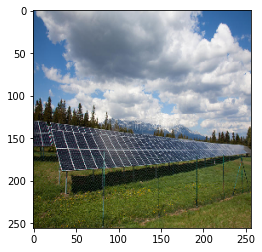

Predict: partial_snow with a 46.54% confidence. Actually belongs to: no_snow


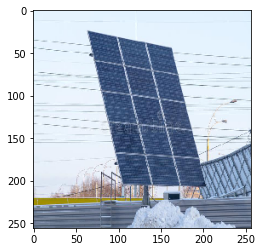

Predict: partial_snow with a 56.61% confidence. Actually belongs to: no_snow


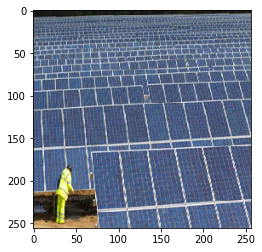

Predict: no_snow with a 57.61% confidence. Actually belongs to: no_snow


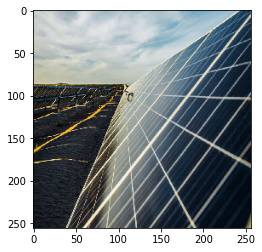

Predict: no_snow with a 46.48% confidence. Actually belongs to: no_snow


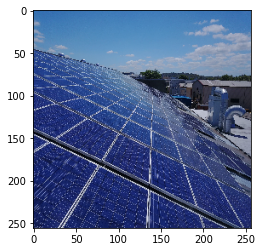

Predict: no_snow with a 56.27% confidence. Actually belongs to: no_snow


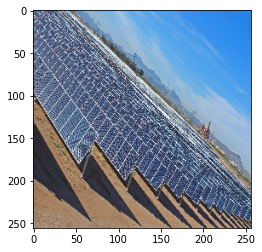

Predict: partial_snow with a 54.05% confidence. Actually belongs to: no_snow


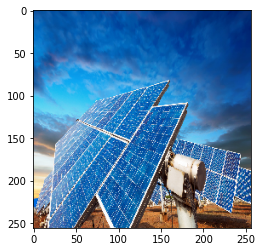

Predict: no_snow with a 57.51% confidence. Actually belongs to: no_snow


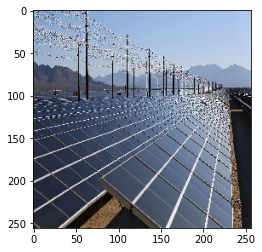

Predict: partial_snow with a 56.74% confidence. Actually belongs to: no_snow


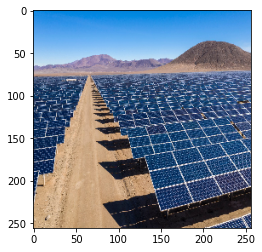

Predict: no_snow with a 57.60% confidence. Actually belongs to: no_snow


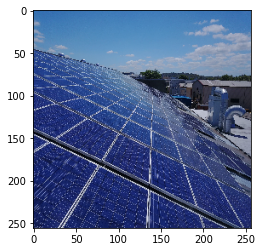

Predict: no_snow with a 56.27% confidence. Actually belongs to: no_snow


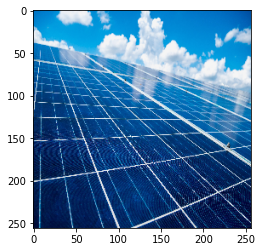

Predict: no_snow with a 57.61% confidence. Actually belongs to: no_snow


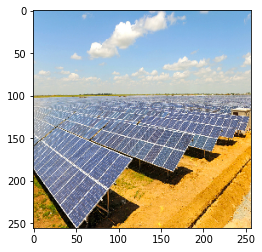

Predict: partial_snow with a 56.35% confidence. Actually belongs to: no_snow


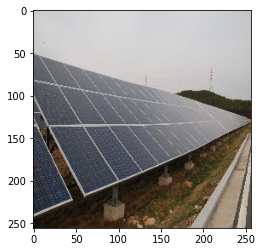

Predict: no_snow with a 57.56% confidence. Actually belongs to: no_snow


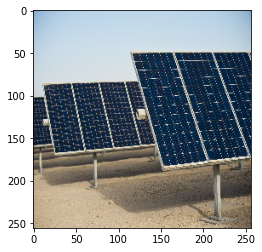

Predict: no_snow with a 57.61% confidence. Actually belongs to: no_snow


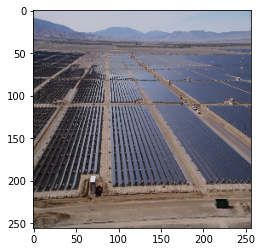

Predict: partial_snow with a 52.15% confidence. Actually belongs to: no_snow


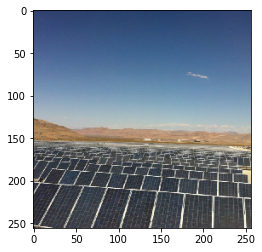

Predict: no_snow with a 57.61% confidence. Actually belongs to: no_snow


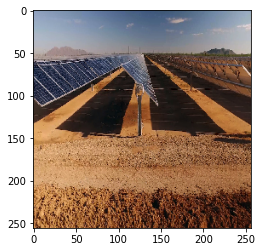

Predict: partial_snow with a 57.10% confidence. Actually belongs to: no_snow


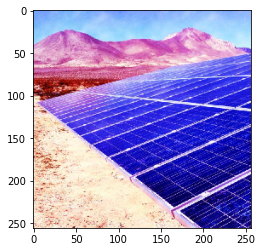

Predict: partial_snow with a 57.57% confidence. Actually belongs to: no_snow


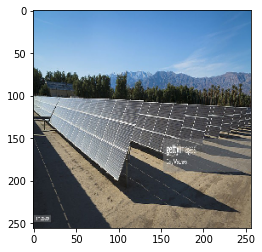

Predict: partial_snow with a 51.19% confidence. Actually belongs to: no_snow


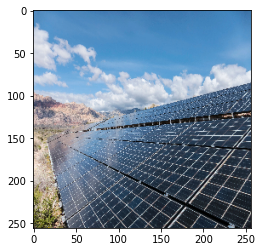

Predict: partial_snow with a 46.58% confidence. Actually belongs to: no_snow


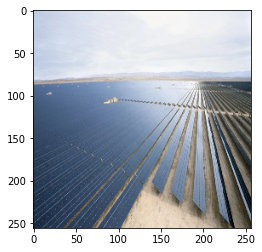

Predict: all_snow with a 47.82% confidence. Actually belongs to: no_snow


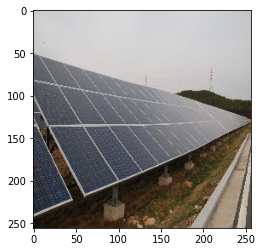

Predict: no_snow with a 57.56% confidence. Actually belongs to: no_snow


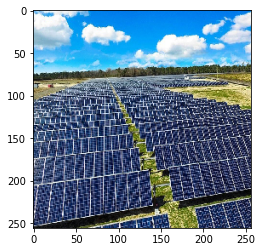

Predict: no_snow with a 57.61% confidence. Actually belongs to: no_snow


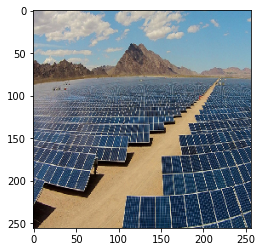

Predict: no_snow with a 57.61% confidence. Actually belongs to: no_snow


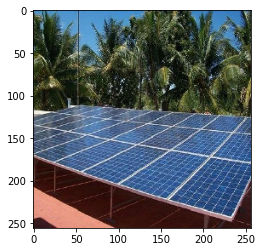

Predict: no_snow with a 54.00% confidence. Actually belongs to: no_snow


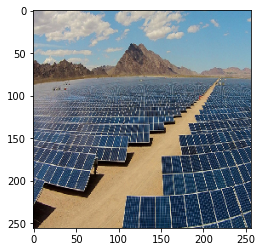

Predict: no_snow with a 57.61% confidence. Actually belongs to: no_snow


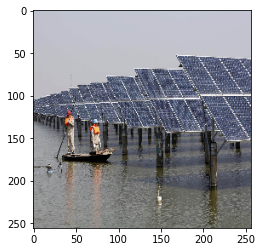

Predict: partial_snow with a 57.01% confidence. Actually belongs to: no_snow


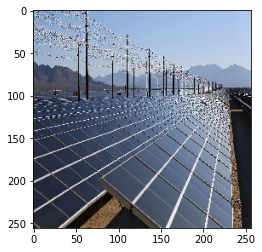

Predict: partial_snow with a 56.74% confidence. Actually belongs to: no_snow


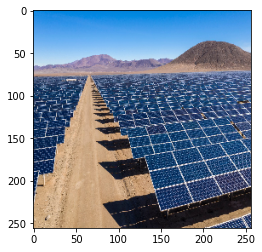

Predict: no_snow with a 57.60% confidence. Actually belongs to: no_snow


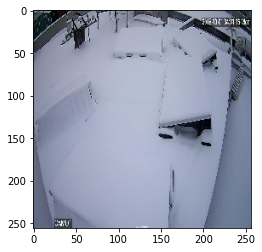

Predict: all_snow with a 56.51% confidence. Actually belongs to: all_snow


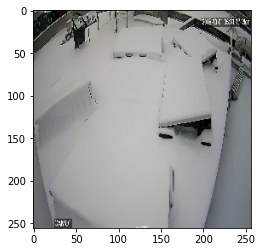

Predict: all_snow with a 57.58% confidence. Actually belongs to: all_snow


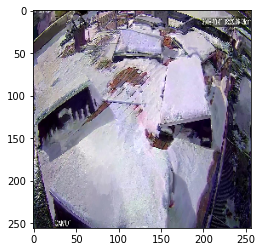

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


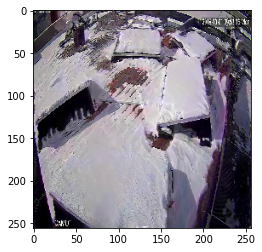

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


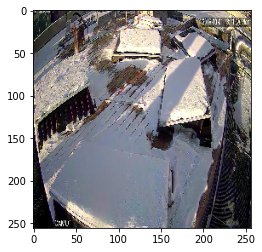

Predict: all_snow with a 57.57% confidence. Actually belongs to: all_snow


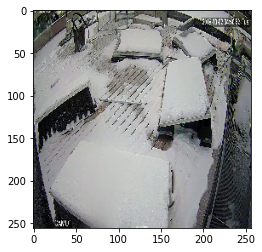

Predict: all_snow with a 57.56% confidence. Actually belongs to: all_snow


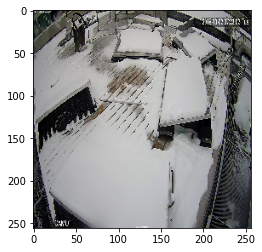

Predict: all_snow with a 57.55% confidence. Actually belongs to: all_snow


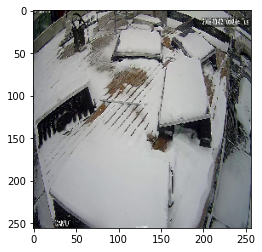

Predict: all_snow with a 57.55% confidence. Actually belongs to: all_snow


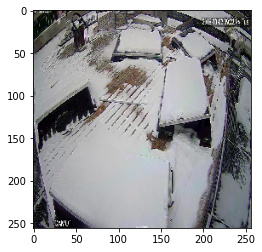

Predict: all_snow with a 57.59% confidence. Actually belongs to: all_snow


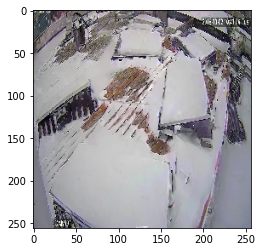

Predict: all_snow with a 57.54% confidence. Actually belongs to: all_snow


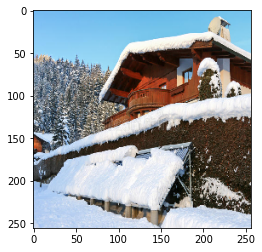

Predict: all_snow with a 57.58% confidence. Actually belongs to: all_snow


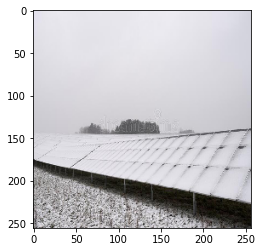

Predict: all_snow with a 57.57% confidence. Actually belongs to: all_snow


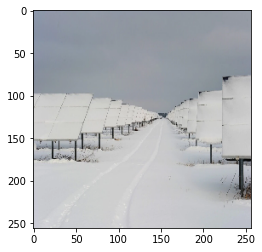

Predict: all_snow with a 57.57% confidence. Actually belongs to: all_snow


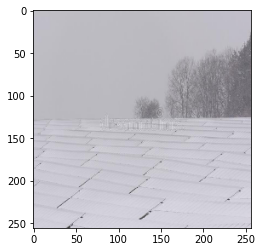

Predict: all_snow with a 57.13% confidence. Actually belongs to: all_snow


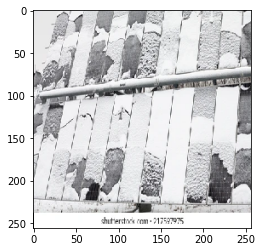

Predict: all_snow with a 57.60% confidence. Actually belongs to: all_snow


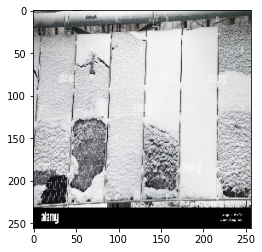

Predict: all_snow with a 57.60% confidence. Actually belongs to: all_snow


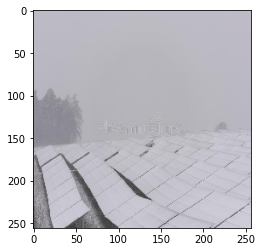

Predict: all_snow with a 57.39% confidence. Actually belongs to: all_snow


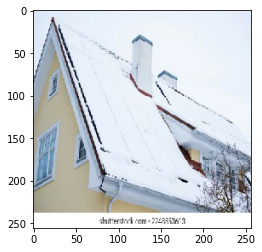

Predict: all_snow with a 57.58% confidence. Actually belongs to: all_snow


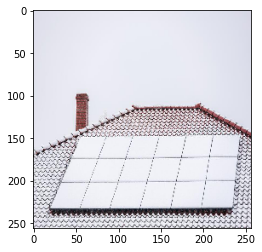

Predict: all_snow with a 57.60% confidence. Actually belongs to: all_snow


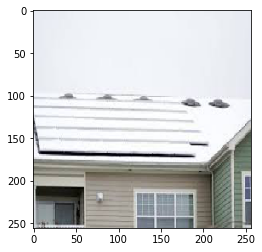

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


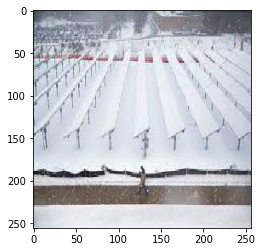

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


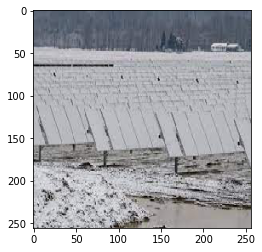

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


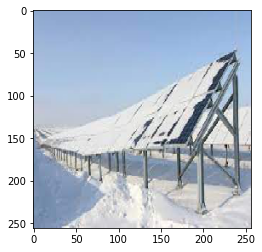

Predict: all_snow with a 57.50% confidence. Actually belongs to: all_snow


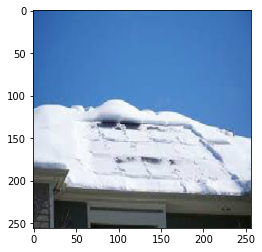

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


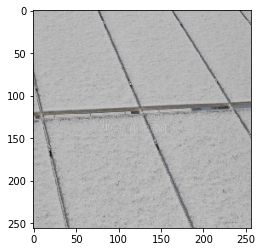

Predict: all_snow with a 57.53% confidence. Actually belongs to: all_snow


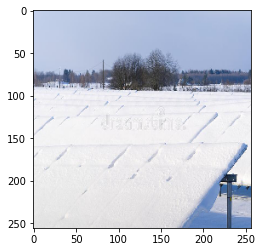

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


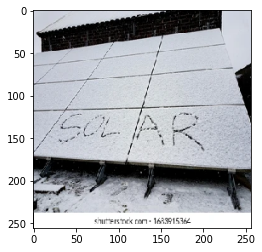

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


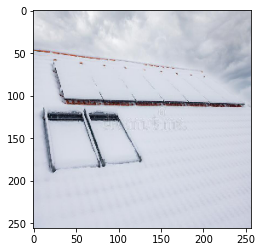

Predict: all_snow with a 57.37% confidence. Actually belongs to: all_snow


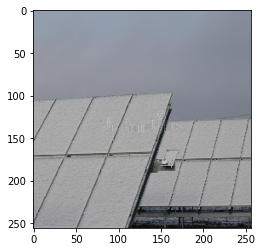

Predict: all_snow with a 57.46% confidence. Actually belongs to: all_snow


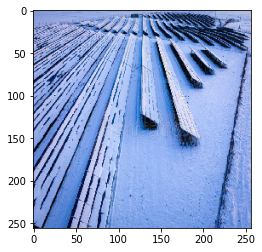

Predict: partial_snow with a 42.91% confidence. Actually belongs to: all_snow


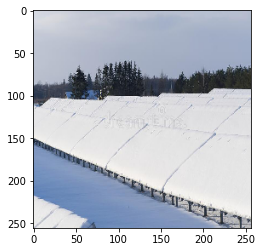

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


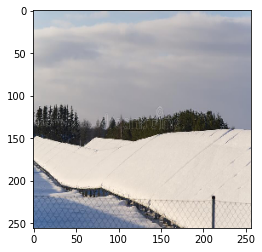

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


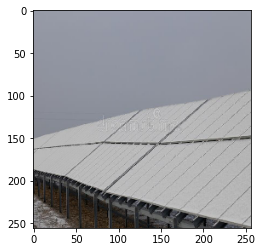

Predict: all_snow with a 57.54% confidence. Actually belongs to: all_snow


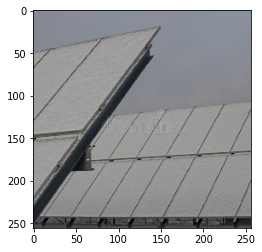

Predict: all_snow with a 57.41% confidence. Actually belongs to: all_snow


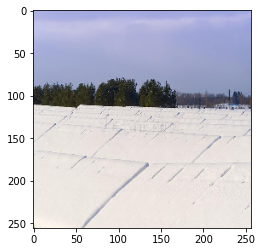

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


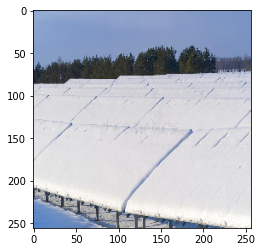

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


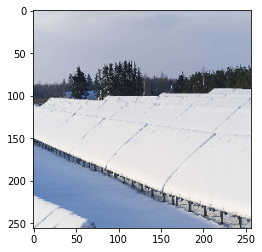

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


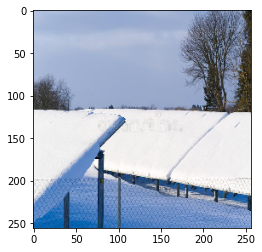

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


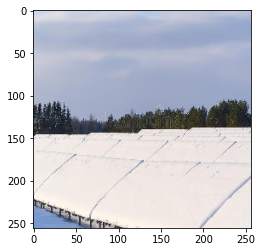

Predict: all_snow with a 57.60% confidence. Actually belongs to: all_snow


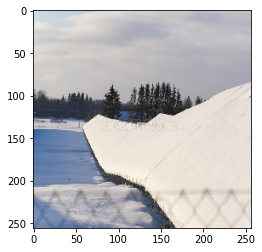

Predict: all_snow with a 57.56% confidence. Actually belongs to: all_snow


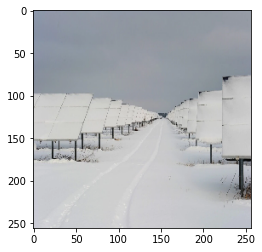

Predict: all_snow with a 57.57% confidence. Actually belongs to: all_snow


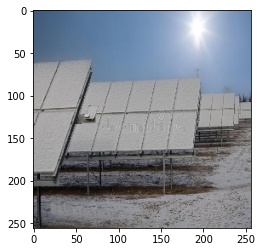

Predict: all_snow with a 57.48% confidence. Actually belongs to: all_snow


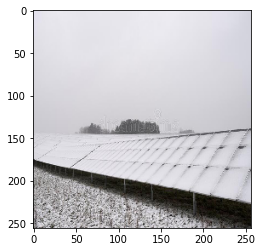

Predict: all_snow with a 57.57% confidence. Actually belongs to: all_snow


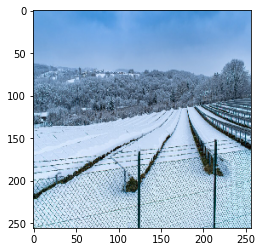

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


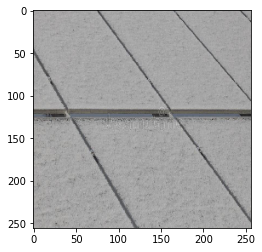

Predict: all_snow with a 57.52% confidence. Actually belongs to: all_snow


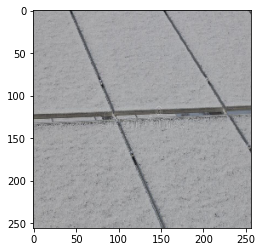

Predict: all_snow with a 57.46% confidence. Actually belongs to: all_snow


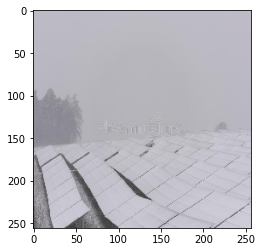

Predict: all_snow with a 57.39% confidence. Actually belongs to: all_snow


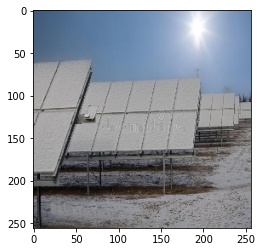

Predict: all_snow with a 57.48% confidence. Actually belongs to: all_snow


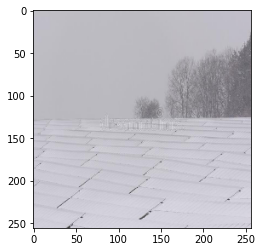

Predict: all_snow with a 57.13% confidence. Actually belongs to: all_snow


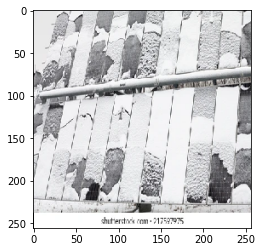

Predict: all_snow with a 57.60% confidence. Actually belongs to: all_snow


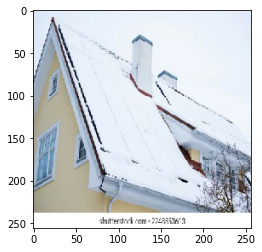

Predict: all_snow with a 57.58% confidence. Actually belongs to: all_snow


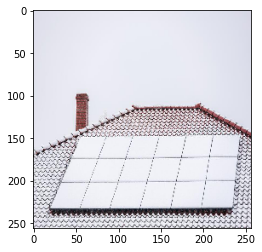

Predict: all_snow with a 57.60% confidence. Actually belongs to: all_snow


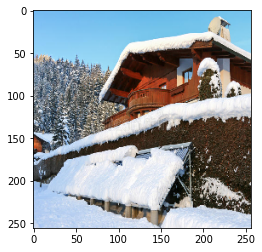

Predict: all_snow with a 57.58% confidence. Actually belongs to: all_snow


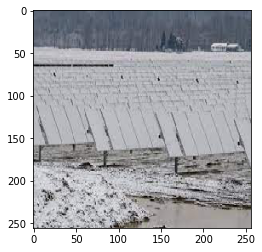

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


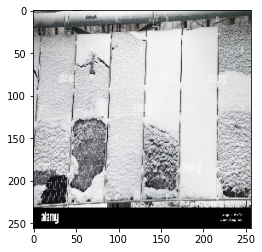

Predict: all_snow with a 57.60% confidence. Actually belongs to: all_snow


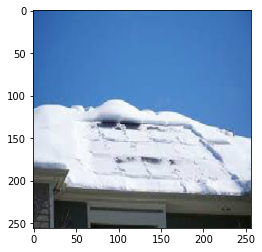

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


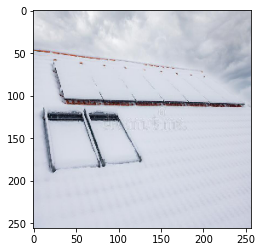

Predict: all_snow with a 57.37% confidence. Actually belongs to: all_snow


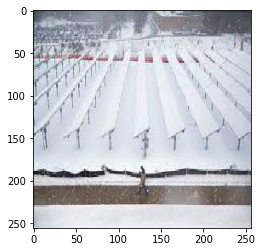

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


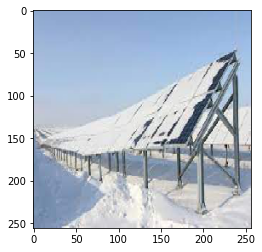

Predict: all_snow with a 57.50% confidence. Actually belongs to: all_snow


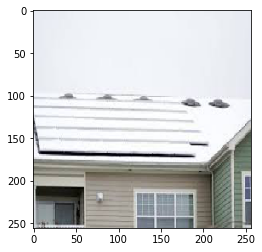

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


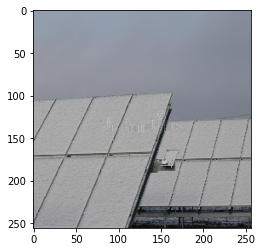

Predict: all_snow with a 57.46% confidence. Actually belongs to: all_snow


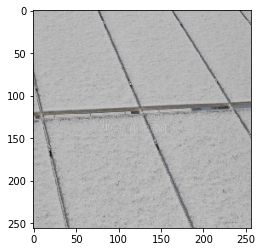

Predict: all_snow with a 57.53% confidence. Actually belongs to: all_snow


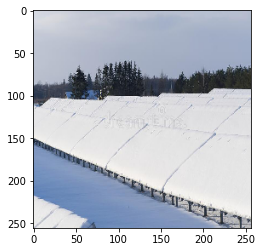

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


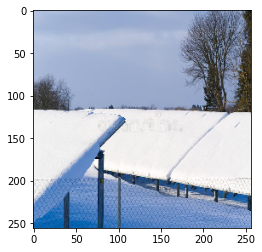

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


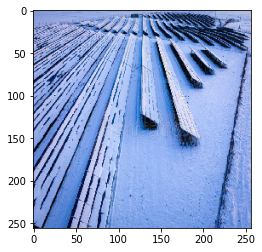

Predict: partial_snow with a 42.91% confidence. Actually belongs to: all_snow


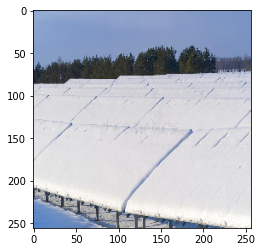

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


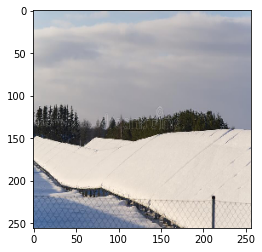

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


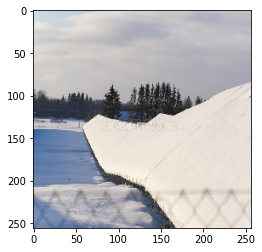

Predict: all_snow with a 57.56% confidence. Actually belongs to: all_snow


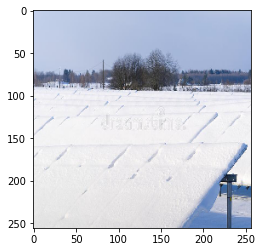

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


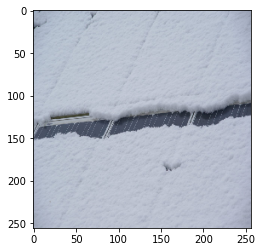

Predict: partial_snow with a 51.75% confidence. Actually belongs to: all_snow


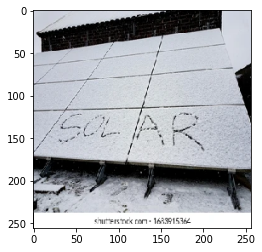

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


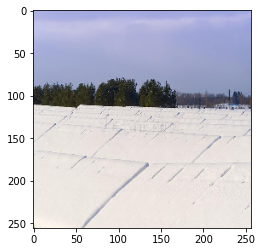

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


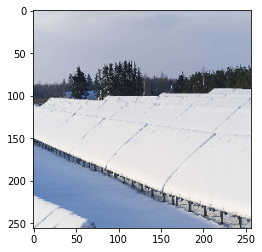

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


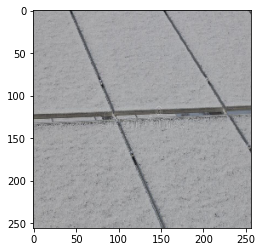

Predict: all_snow with a 57.46% confidence. Actually belongs to: all_snow


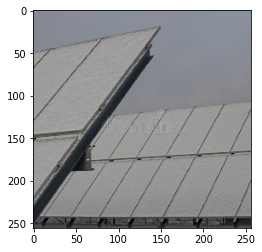

Predict: all_snow with a 57.41% confidence. Actually belongs to: all_snow


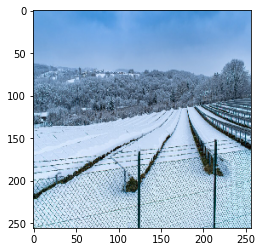

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


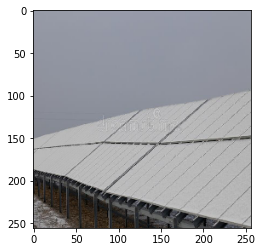

Predict: all_snow with a 57.54% confidence. Actually belongs to: all_snow


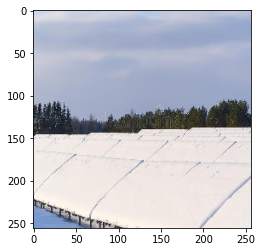

Predict: all_snow with a 57.60% confidence. Actually belongs to: all_snow


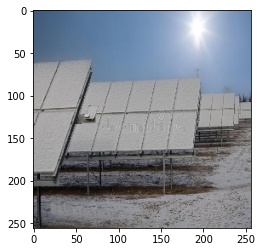

Predict: all_snow with a 57.48% confidence. Actually belongs to: all_snow


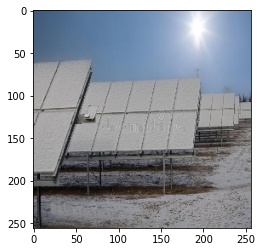

Predict: all_snow with a 57.48% confidence. Actually belongs to: all_snow


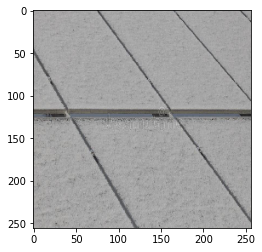

Predict: all_snow with a 57.52% confidence. Actually belongs to: all_snow


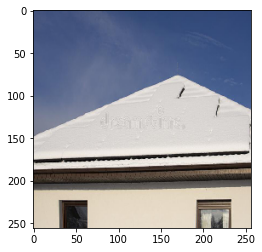

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


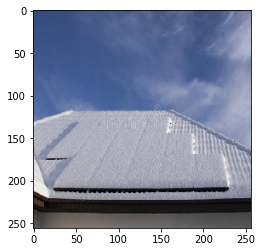

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


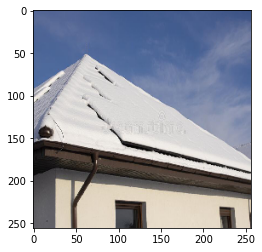

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


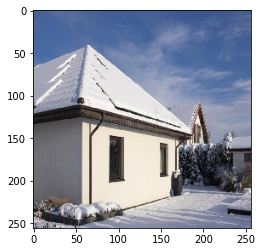

Predict: all_snow with a 57.60% confidence. Actually belongs to: all_snow


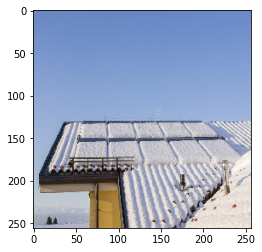

Predict: all_snow with a 57.52% confidence. Actually belongs to: all_snow


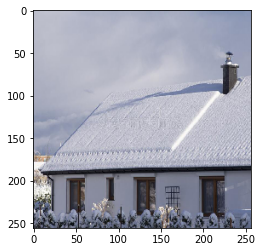

Predict: all_snow with a 57.58% confidence. Actually belongs to: all_snow


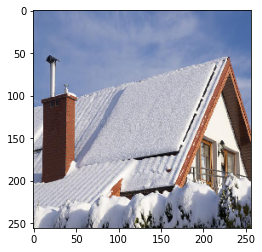

Predict: all_snow with a 57.21% confidence. Actually belongs to: all_snow


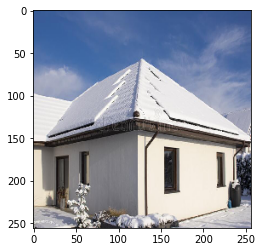

Predict: all_snow with a 57.60% confidence. Actually belongs to: all_snow


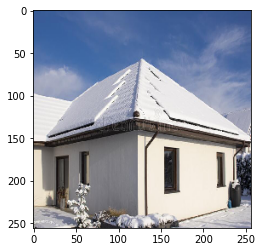

Predict: all_snow with a 57.60% confidence. Actually belongs to: all_snow


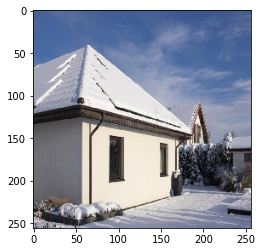

Predict: all_snow with a 57.60% confidence. Actually belongs to: all_snow


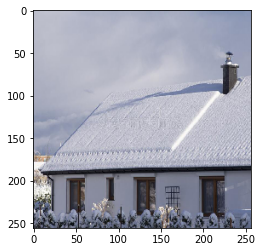

Predict: all_snow with a 57.58% confidence. Actually belongs to: all_snow


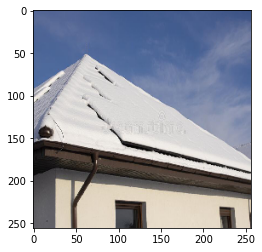

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


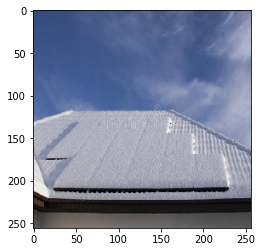

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


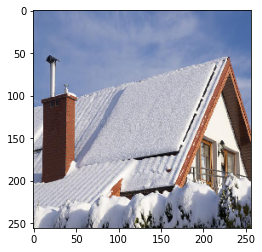

Predict: all_snow with a 57.21% confidence. Actually belongs to: all_snow


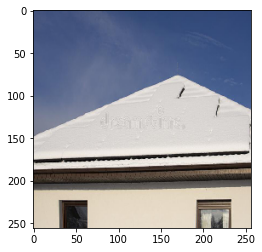

Predict: all_snow with a 57.61% confidence. Actually belongs to: all_snow


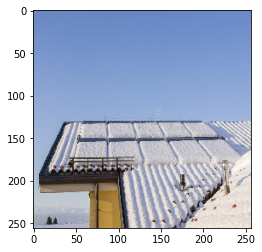

Predict: all_snow with a 57.52% confidence. Actually belongs to: all_snow


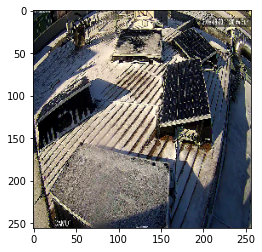

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


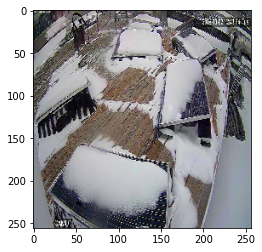

Predict: all_snow with a 57.02% confidence. Actually belongs to: partial_snow


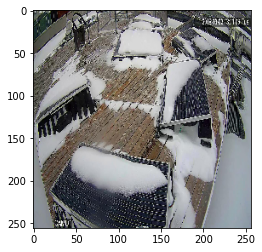

Predict: all_snow with a 53.56% confidence. Actually belongs to: partial_snow


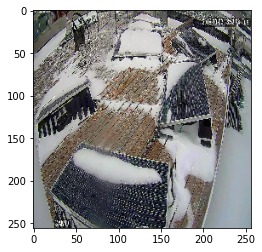

Predict: all_snow with a 50.95% confidence. Actually belongs to: partial_snow


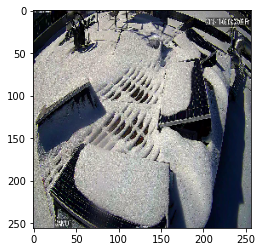

Predict: all_snow with a 49.78% confidence. Actually belongs to: partial_snow


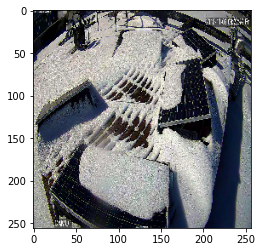

Predict: partial_snow with a 46.67% confidence. Actually belongs to: partial_snow


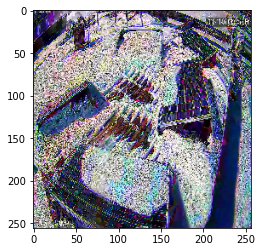

Predict: all_snow with a 57.61% confidence. Actually belongs to: partial_snow


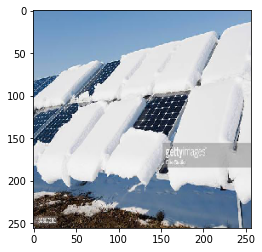

Predict: all_snow with a 55.19% confidence. Actually belongs to: partial_snow


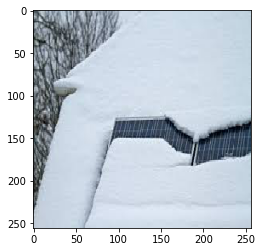

Predict: partial_snow with a 57.55% confidence. Actually belongs to: partial_snow


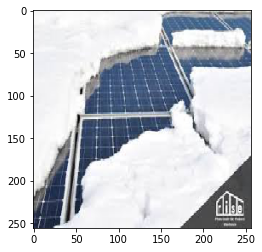

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


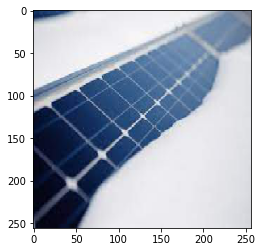

Predict: partial_snow with a 57.39% confidence. Actually belongs to: partial_snow


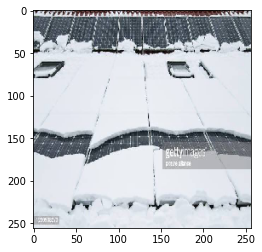

Predict: all_snow with a 41.92% confidence. Actually belongs to: partial_snow


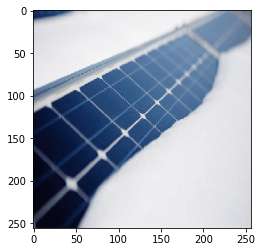

Predict: partial_snow with a 57.37% confidence. Actually belongs to: partial_snow


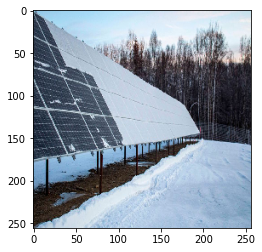

Predict: partial_snow with a 55.16% confidence. Actually belongs to: partial_snow


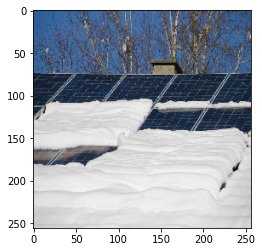

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


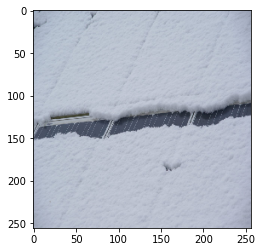

Predict: partial_snow with a 51.75% confidence. Actually belongs to: partial_snow


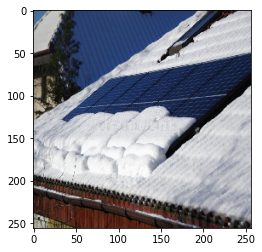

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


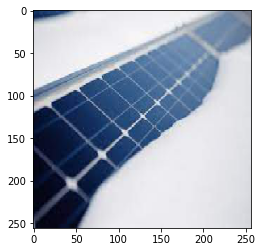

Predict: partial_snow with a 57.39% confidence. Actually belongs to: partial_snow


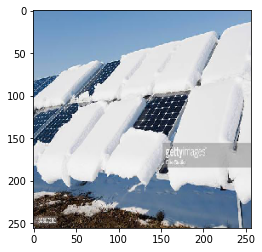

Predict: all_snow with a 55.19% confidence. Actually belongs to: partial_snow


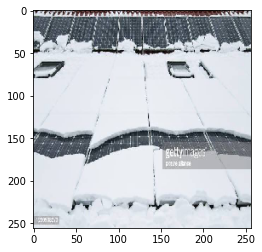

Predict: all_snow with a 41.92% confidence. Actually belongs to: partial_snow


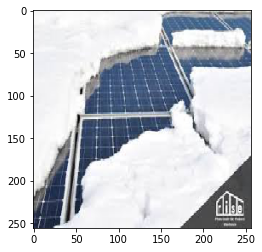

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


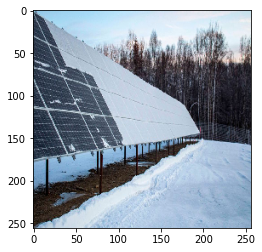

Predict: partial_snow with a 55.16% confidence. Actually belongs to: partial_snow


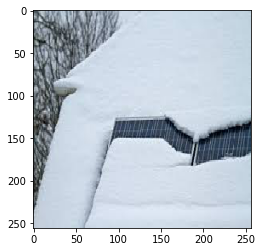

Predict: partial_snow with a 57.55% confidence. Actually belongs to: partial_snow


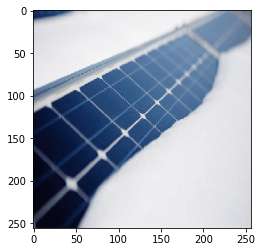

Predict: partial_snow with a 57.37% confidence. Actually belongs to: partial_snow


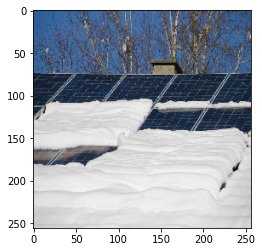

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


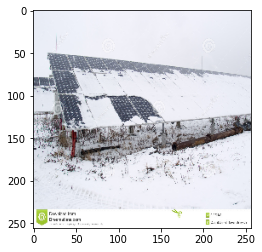

Predict: all_snow with a 57.24% confidence. Actually belongs to: partial_snow


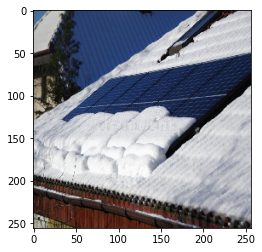

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


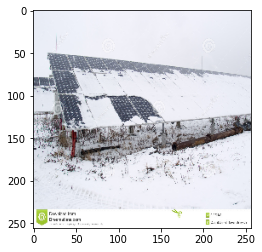

Predict: all_snow with a 57.24% confidence. Actually belongs to: partial_snow


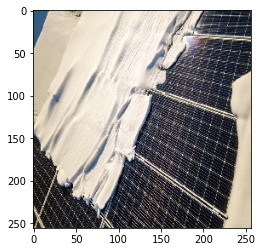

Predict: all_snow with a 49.93% confidence. Actually belongs to: partial_snow


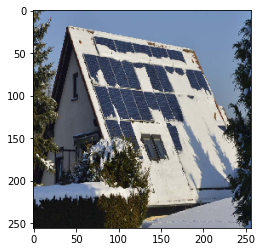

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


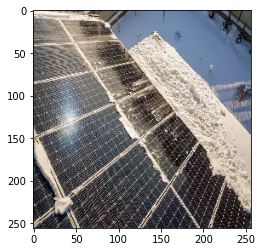

Predict: all_snow with a 40.45% confidence. Actually belongs to: partial_snow


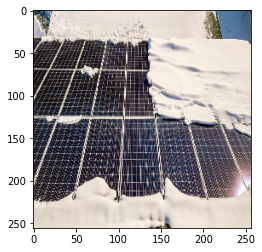

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


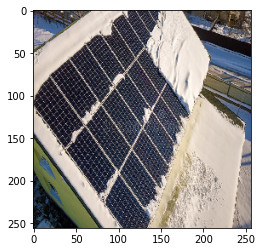

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


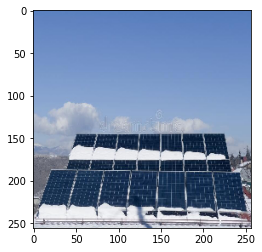

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


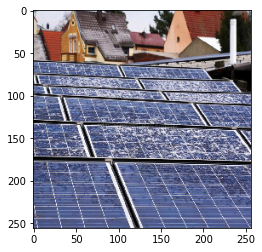

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


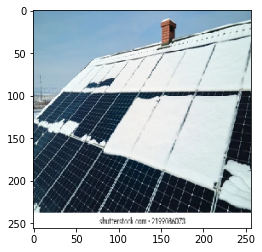

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


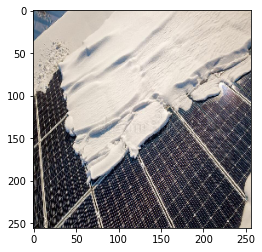

Predict: all_snow with a 57.59% confidence. Actually belongs to: partial_snow


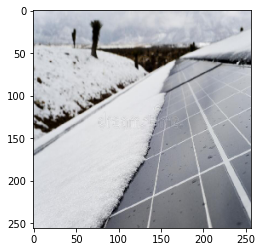

Predict: partial_snow with a 53.59% confidence. Actually belongs to: partial_snow


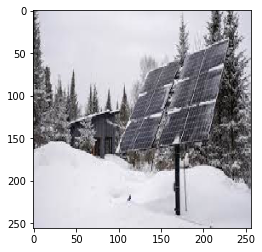

Predict: all_snow with a 47.57% confidence. Actually belongs to: partial_snow


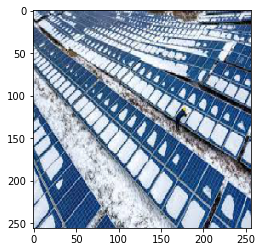

Predict: partial_snow with a 44.27% confidence. Actually belongs to: partial_snow


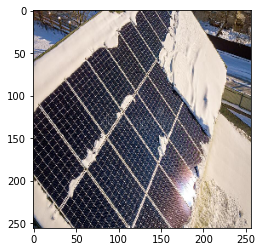

Predict: partial_snow with a 57.59% confidence. Actually belongs to: partial_snow


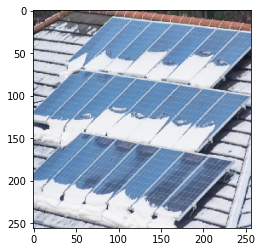

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


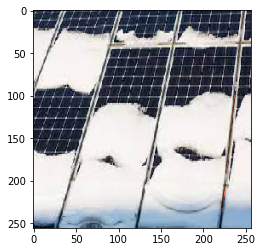

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


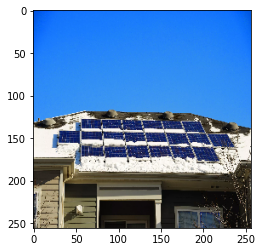

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


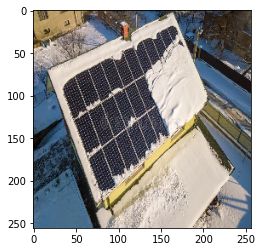

Predict: partial_snow with a 57.26% confidence. Actually belongs to: partial_snow


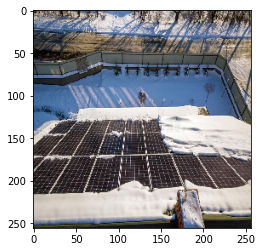

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


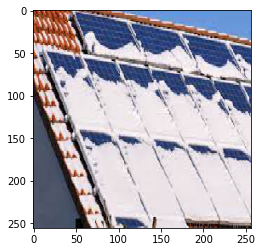

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


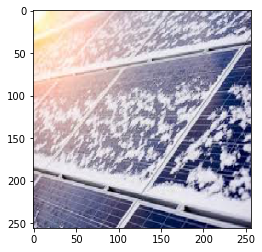

Predict: partial_snow with a 57.54% confidence. Actually belongs to: partial_snow


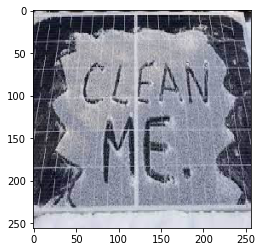

Predict: all_snow with a 57.49% confidence. Actually belongs to: partial_snow


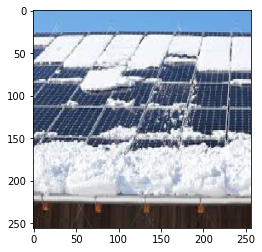

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


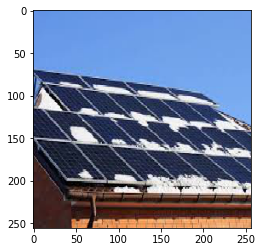

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


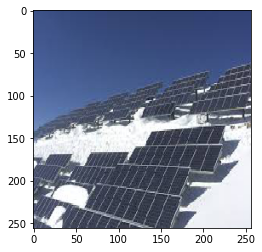

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


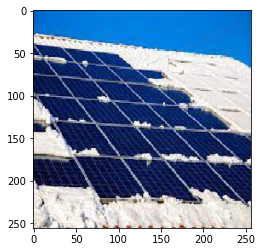

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


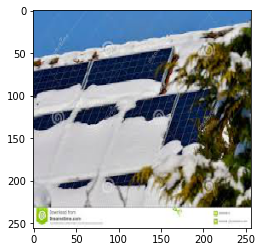

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


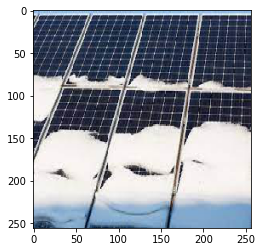

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


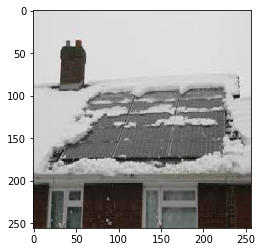

Predict: partial_snow with a 57.01% confidence. Actually belongs to: partial_snow


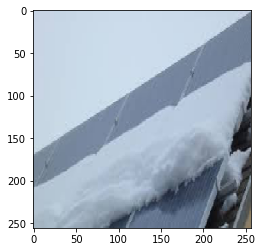

Predict: all_snow with a 47.56% confidence. Actually belongs to: partial_snow


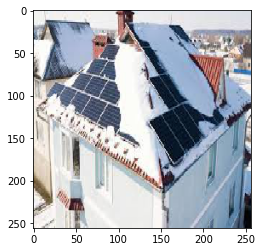

Predict: partial_snow with a 57.60% confidence. Actually belongs to: partial_snow


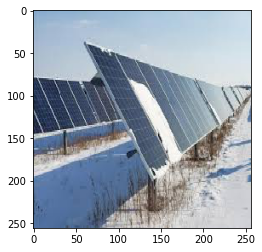

Predict: partial_snow with a 57.45% confidence. Actually belongs to: partial_snow


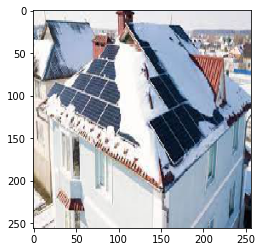

Predict: partial_snow with a 57.59% confidence. Actually belongs to: partial_snow


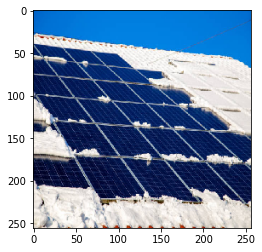

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


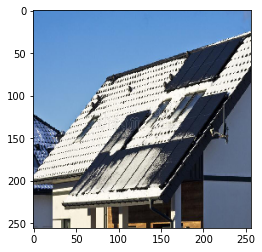

Predict: partial_snow with a 57.60% confidence. Actually belongs to: partial_snow


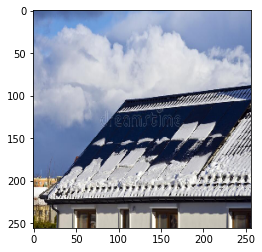

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


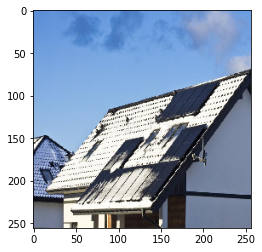

Predict: partial_snow with a 57.07% confidence. Actually belongs to: partial_snow


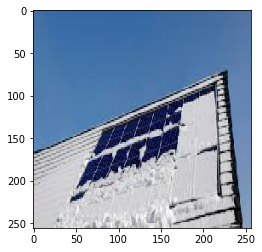

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


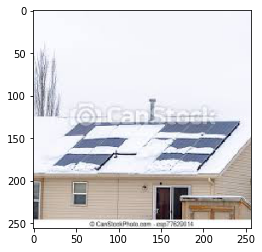

Predict: partial_snow with a 56.74% confidence. Actually belongs to: partial_snow


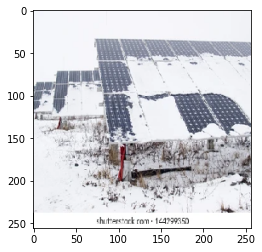

Predict: partial_snow with a 57.31% confidence. Actually belongs to: partial_snow


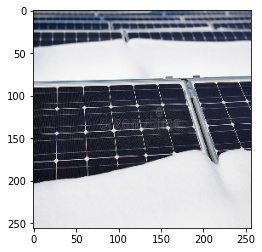

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


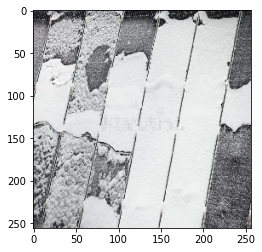

Predict: all_snow with a 57.61% confidence. Actually belongs to: partial_snow


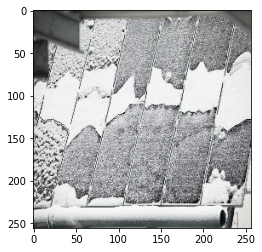

Predict: all_snow with a 57.61% confidence. Actually belongs to: partial_snow


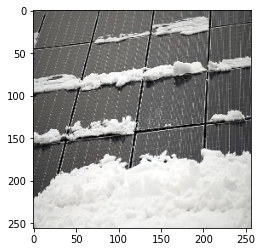

Predict: partial_snow with a 57.58% confidence. Actually belongs to: partial_snow


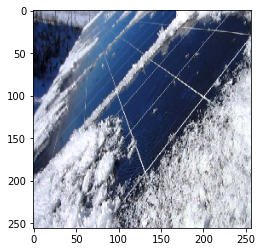

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


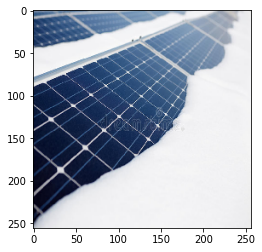

Predict: partial_snow with a 57.48% confidence. Actually belongs to: partial_snow


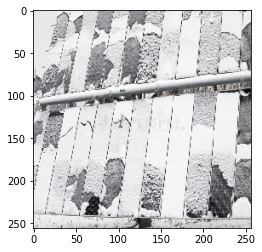

Predict: all_snow with a 57.60% confidence. Actually belongs to: partial_snow


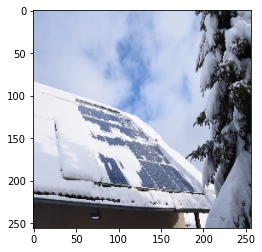

Predict: partial_snow with a 46.17% confidence. Actually belongs to: partial_snow


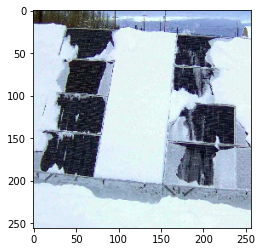

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


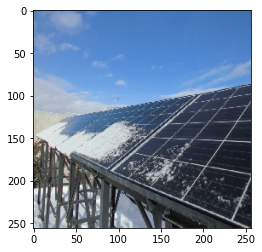

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


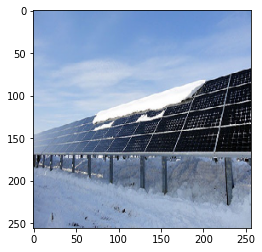

Predict: partial_snow with a 57.61% confidence. Actually belongs to: partial_snow


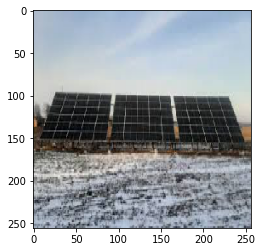

Predict: partial_snow with a 44.30% confidence. Actually belongs to: ground_snow


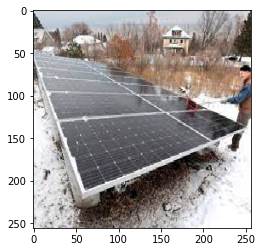

Predict: partial_snow with a 56.81% confidence. Actually belongs to: ground_snow


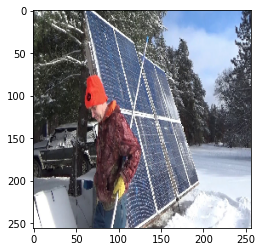

Predict: partial_snow with a 56.81% confidence. Actually belongs to: ground_snow


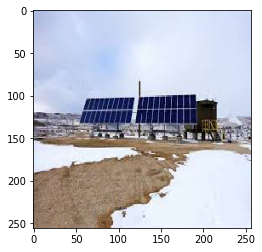

Predict: partial_snow with a 57.61% confidence. Actually belongs to: ground_snow


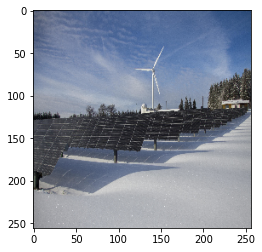

Predict: partial_snow with a 57.42% confidence. Actually belongs to: ground_snow


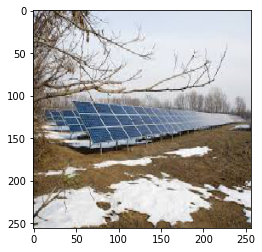

Predict: partial_snow with a 57.52% confidence. Actually belongs to: ground_snow


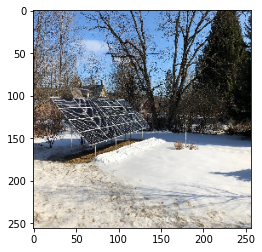

Predict: all_snow with a 57.43% confidence. Actually belongs to: ground_snow


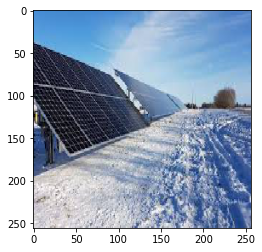

Predict: partial_snow with a 53.70% confidence. Actually belongs to: ground_snow


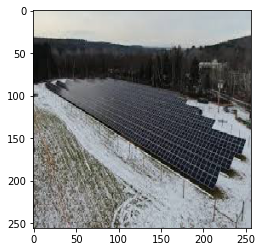

Predict: all_snow with a 57.49% confidence. Actually belongs to: ground_snow


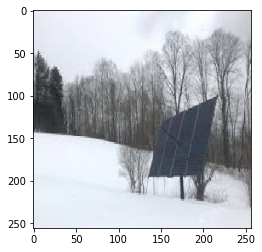

Predict: all_snow with a 56.93% confidence. Actually belongs to: ground_snow


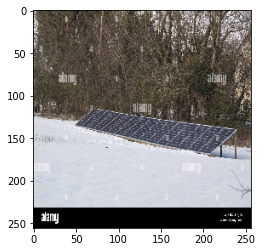

Predict: all_snow with a 47.28% confidence. Actually belongs to: ground_snow


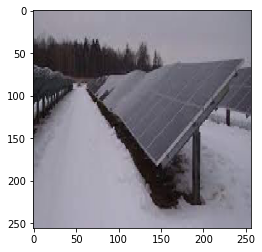

Predict: all_snow with a 46.52% confidence. Actually belongs to: ground_snow


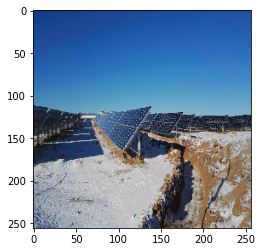

Predict: partial_snow with a 56.54% confidence. Actually belongs to: ground_snow


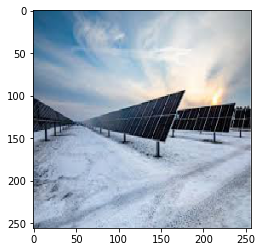

Predict: partial_snow with a 57.02% confidence. Actually belongs to: ground_snow


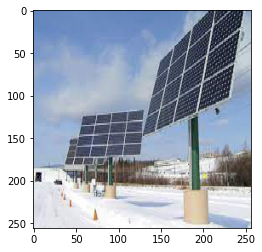

Predict: partial_snow with a 51.75% confidence. Actually belongs to: ground_snow


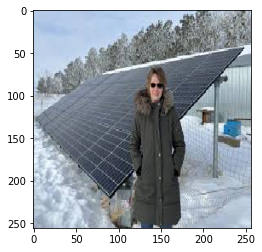

Predict: partial_snow with a 52.57% confidence. Actually belongs to: ground_snow


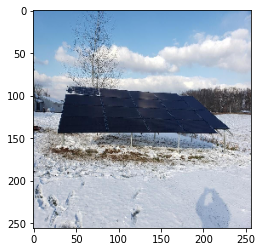

Predict: all_snow with a 44.43% confidence. Actually belongs to: ground_snow


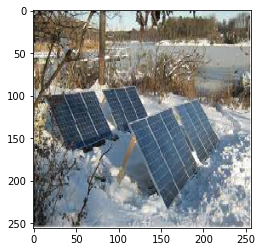

Predict: partial_snow with a 57.37% confidence. Actually belongs to: ground_snow


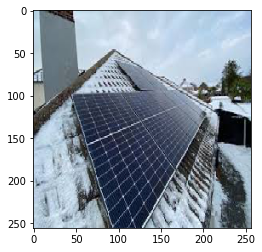

Predict: partial_snow with a 57.55% confidence. Actually belongs to: ground_snow


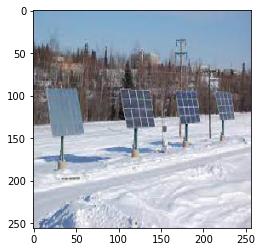

Predict: all_snow with a 44.30% confidence. Actually belongs to: ground_snow


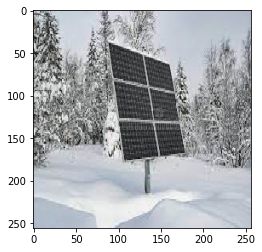

Predict: partial_snow with a 57.54% confidence. Actually belongs to: ground_snow


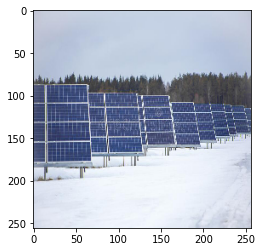

Predict: partial_snow with a 44.91% confidence. Actually belongs to: ground_snow


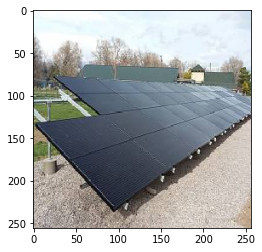

Predict: partial_snow with a 39.47% confidence. Actually belongs to: ground_snow


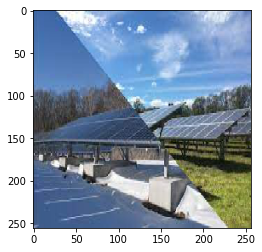

Predict: partial_snow with a 57.53% confidence. Actually belongs to: ground_snow


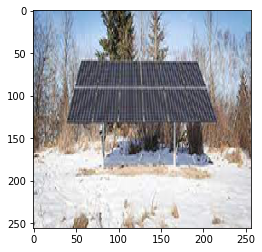

Predict: partial_snow with a 55.96% confidence. Actually belongs to: ground_snow


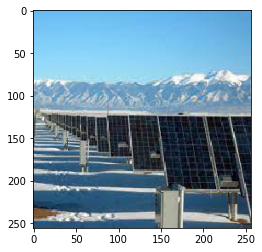

Predict: partial_snow with a 56.78% confidence. Actually belongs to: ground_snow


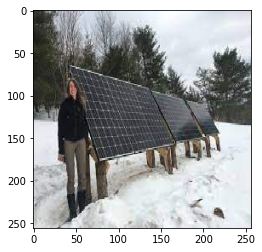

Predict: partial_snow with a 43.62% confidence. Actually belongs to: ground_snow


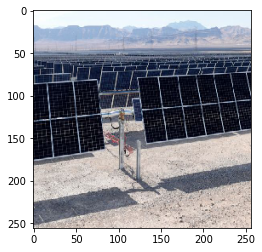

Predict: partial_snow with a 57.61% confidence. Actually belongs to: ground_snow


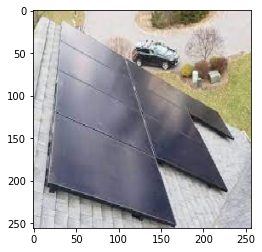

Predict: partial_snow with a 52.76% confidence. Actually belongs to: ground_snow


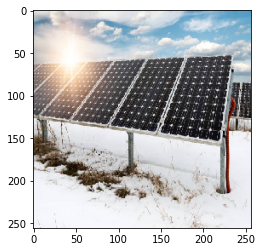

Predict: partial_snow with a 54.14% confidence. Actually belongs to: ground_snow


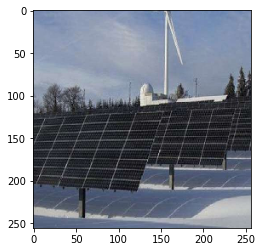

Predict: partial_snow with a 56.80% confidence. Actually belongs to: ground_snow


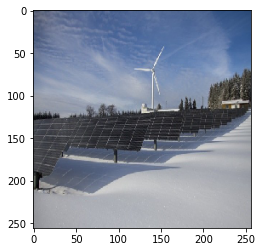

Predict: partial_snow with a 57.29% confidence. Actually belongs to: ground_snow


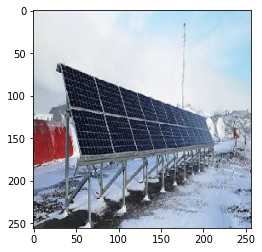

Predict: partial_snow with a 57.61% confidence. Actually belongs to: ground_snow


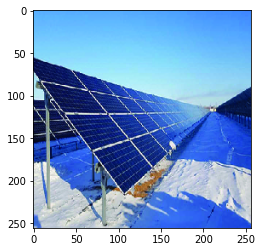

Predict: no_snow with a 47.35% confidence. Actually belongs to: ground_snow


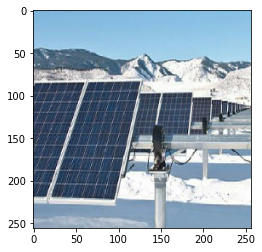

Predict: partial_snow with a 57.61% confidence. Actually belongs to: ground_snow


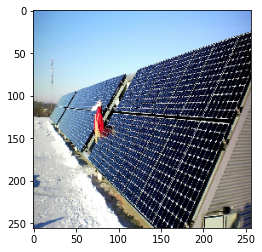

Predict: no_snow with a 57.61% confidence. Actually belongs to: ground_snow


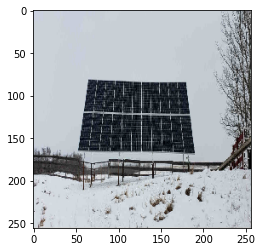

Predict: partial_snow with a 57.61% confidence. Actually belongs to: ground_snow


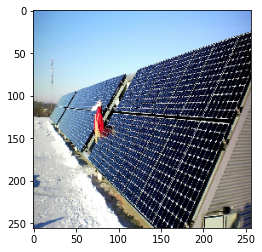

Predict: no_snow with a 57.61% confidence. Actually belongs to: ground_snow


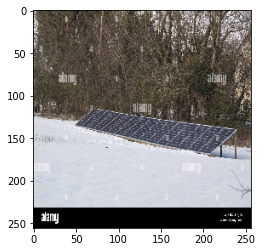

Predict: all_snow with a 47.28% confidence. Actually belongs to: ground_snow


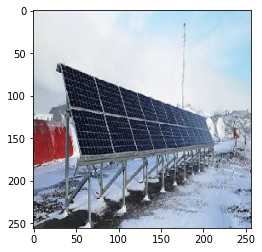

Predict: partial_snow with a 57.61% confidence. Actually belongs to: ground_snow


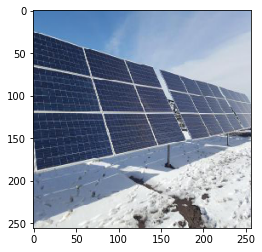

Predict: partial_snow with a 48.38% confidence. Actually belongs to: ground_snow


In [18]:
# img_path = img_path = "/content/gdrive/MyDrive/Snow_Covered_Solar_Panel_Detect/snow_and_nosnow_images/validate/snow/Copy of Copy of house-roof-covered-solar-panels-winter-snow-top-energy-efficiency-maintenance-concept-195932215.jpg"
# img_path = "/content/gdrive/MyDrive/Snow_Covered_Solar_Panel_Detect/snow_and_nosnow_images/validate/snow/Copy of Copy of house-roof-covered-solar-panels-winter-snow-top-energy-efficiency-maintenance-concept-195932215.jpg"
# img_path = "/content/gdrive/MyDrive/Snow_Covered_Solar_Panel_Detect/snow_and_nosnow_images/validate/snow/Copy of snow_on_solar_10.jpg.webp"
# img_path = "/content/gdrive/MyDrive/Snow_Covered_Solar_Panel_Detect/snow_and_nosnow_images/validate/no_snow/Copy of Copy of photovoltaic-home-solar-panels-work-sunny-snow-low-temperatures-performance-decreases-exponentially-255444591.jpg"

for img_path in os.listdir("/content/gdrive/MyDrive/Snow_Covered_Solar_Panel_Detect/Images/test/no_snow"):
  predict_from_three_classes(TF_MODEL_FILE_PATH, class_dict, (os.path.join("/content/gdrive/MyDrive/Snow_Covered_Solar_Panel_Detect/Images/test/no_snow", img_path)), size=(256, 256))

for img_path in os.listdir("/content/gdrive/MyDrive/Snow_Covered_Solar_Panel_Detect/Images/test/all_snow"):
  predict_from_three_classes(TF_MODEL_FILE_PATH, class_dict, (os.path.join("/content/gdrive/MyDrive/Snow_Covered_Solar_Panel_Detect/Images/test/all_snow", img_path)), size=(256, 256))

for img_path in os.listdir("/content/gdrive/MyDrive/Snow_Covered_Solar_Panel_Detect/Images/test/partial_snow"):
  predict_from_three_classes(TF_MODEL_FILE_PATH, class_dict, (os.path.join("/content/gdrive/MyDrive/Snow_Covered_Solar_Panel_Detect/Images/test/partial_snow", img_path)), size=(256, 256))

for img_path in os.listdir("/content/gdrive/MyDrive/Snow_Covered_Solar_Panel_Detect/Images/test/ground_snow"):
  predict_from_three_classes(TF_MODEL_FILE_PATH, class_dict, (os.path.join("/content/gdrive/MyDrive/Snow_Covered_Solar_Panel_Detect/Images/test/ground_snow", img_path)), size=(256, 256))


## It will detect using both model and do the final predict

In [19]:
def final_predict(tf_model1_file, tf_model2_file, class_dict1, class_dict2, img_path, size=(256, 256)):
  print("\n\nModel 1 prediction: \n")
  model1_predict = predict_from_two_classes(tf_model1_file, class_dict1, img_path, size=(256, 256))
  print("\nModel 2 prediction: \n")
  model2_predict = predict_from_three_classes(tf_model2_file, class_dict2, img_path, size=(256, 256))

  print("-" * 100)
  if model1_predict == 'snow' and (model2_predict == 'partial_snow' or model2_predict == 'no_snow'):
    print("\nFinal prediction: ground_snow")
  else:
    print(f"\nFinal prediction: {model2_predict}")
  print("=" * 100)
  



Model 1 prediction: 



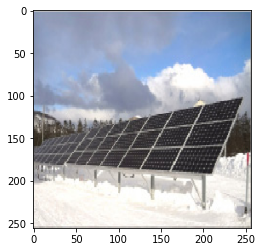

[[0.99190164]]
1
snow

Model 2 prediction: 



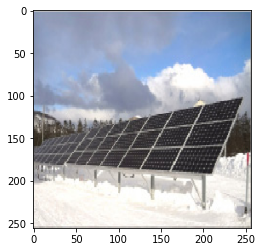

Predict: partial_snow with a 57.61% confidence. Actually belongs to: ground_snow_test
----------------------------------------------------------------------------------------------------

Final prediction: ground_snow


Model 1 prediction: 



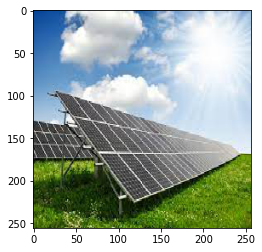

[[0.00027599]]
0
no_snow

Model 2 prediction: 



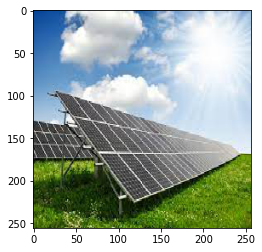

Predict: no_snow with a 35.41% confidence. Actually belongs to: no_snow
----------------------------------------------------------------------------------------------------

Final prediction: no_snow


Model 1 prediction: 



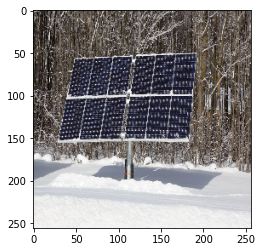

[[0.9817803]]
1
snow

Model 2 prediction: 



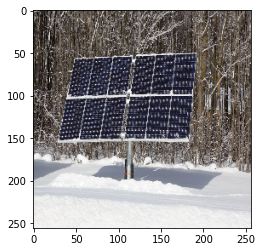

Predict: partial_snow with a 57.61% confidence. Actually belongs to: ground_snow_test
----------------------------------------------------------------------------------------------------

Final prediction: ground_snow


Model 1 prediction: 



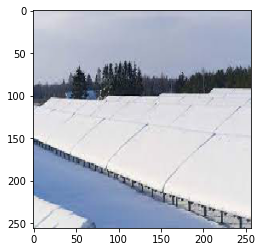

[[0.9999799]]
1
snow

Model 2 prediction: 



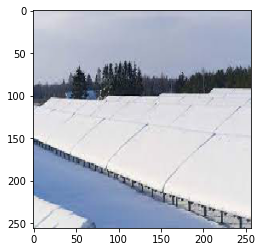

Predict: all_snow with a 57.61% confidence. Actually belongs to: snow
----------------------------------------------------------------------------------------------------

Final prediction: all_snow


In [20]:

class_dict1 = {0: "snow", 1: "no_snow"}
class_dict2 = {0: "all_snow", 1: "no_snow", 2: "partial_snow"}

test_image_paths = ["/content/gdrive/MyDrive/Snow_Covered_Solar_Panel_Detect/additional/ground_snow_test/R (9).jpeg",
                    "/content/gdrive/MyDrive/Snow_Covered_Solar_Panel_Detect/snow_and_nosnow_images/test/no_snow/nosnow3.jpeg",
                    "/content/gdrive/MyDrive/Snow_Covered_Solar_Panel_Detect/additional/ground_snow_test/Do-solar-panels-work-in-the-winter.jpg",
                    "/content/gdrive/MyDrive/Snow_Covered_Solar_Panel_Detect/snow_and_nosnow_images/test/snow/allsnow1.jpeg"]

for img_path in test_image_paths:
  final_predict(tf_model1_file, tf_model2_file, class_dict1, class_dict2, img_path, size=(256, 256))